# Checklist
* Plug in laptop to power
* Connect to Eathernet cable
* Connect to external screen
* Check about dongle with 2 USB-C connections
* Plug in clicker dongle
* Close all other apps
* Have PowerPoint open in browser
* Have downloaded PowerPoint open for case of failure
* Have most recent version of Demo walkthrough is open in Pycharm
* Have run version without speaker notes open in JupyterLab
* Have temporary chat open in ChatGPT with sidebar collapsed
* Have no other tabs other than demo notebooks and ChatGPT
* Have parrot photo already loaded in ChatGPT
* Demo window zoomed to 150%
* Demo notebook in simple presentation mode with no status bar
* Run Setup in empty Demo notebook
* Load CLIP model in empty Demo notebook
* Make sure there's enough money loaded in OpenAI account

# Setup

In [1]:
import os
import base64
from IPython import display
from PIL import Image
import json
from decimal import Decimal
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from dotenv import load_dotenv
from langchain_openai import ChatOpenAI
from langchain_core.messages import SystemMessage, HumanMessage, AIMessage
from langchain_openai import ChatOpenAI
from langchain.prompts import ChatPromptTemplate
from langchain_core.pydantic_v1 import BaseModel, Field
from langchain_core.output_parsers import JsonOutputParser, PydanticOutputParser
import open_clip
from langchain_experimental.open_clip import OpenCLIPEmbeddings
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
# load env variables from .env
load_dotenv()

True

* Let me just pull up a Jupyter notebook and show you how you could do this with a library called langchain.
* I realize this is probably not the IDE most developers are used to working in, and I’m going to be working in Python which may or may not be your language of choice, but just know that the library we’re working with, langchain, is natively supported in JavaScript as well. 

# Create an Instance of a Model

* So in langchain, models like the gpt-4o behind ChatGPT are just objects, and interacting with the model is just a method. 
* So let me create an instance of that GPT-4o model. And then this temperature parameter here is just telling the model not to get too creative. I like to have this set to 0 to start out so that results are a bit more consistent. 
* This is going to be using the ChatOpenAI class since we are using an OpenAI model. But langchain has support for pretty much any llm worth using. 
 

In [3]:
# Live Code
llm = ChatOpenAI(model='gpt-4o', temperature=0.0)
# This temperature just means that we don't want the model getting too creative on us

* Once we have this model instance we can just use the .invoke() method to send the model a message/prompt and get back the response
* Let’s just test it out in the most basic way and ask it for a joke…


In [4]:
# Live Code
# Most simple usage - like ChatGPT
response = llm.invoke('Tell me a joke about pirates.')
print(response.content)

Sure, here's a pirate joke for you:

Why did the pirate go to the Apple Store?

Because he wanted to trade his iPatch for an iPad!


That sounds a lot like a Dad joke you would make 😉

# Use the Image in the Prompt

### Resize the image so there are fewer tokens sent to the model

In [5]:
# image_uri = "./Images/9b676ca511484c774ade4a308d04a518.jpg"
# with Image.open(image_uri) as img:
#     print(img.size)
#     width, height = img.size
#     resized_dim = (int(width*.5), int(height*.5))
#     resized_img = img.resize(resized_dim)
#     print(resized_img.size)
#     resized_img.save(image_uri)
#     resized_img.show()

### Load and Encode the Image

* We actually want to do something a bit more fancy, which is send the model an image to analyze. To do that, we need to first encode the image in base64.
* Here’s a nifty function to do that
 

* Let’s also get a function to display the image to remind us what we’re working with

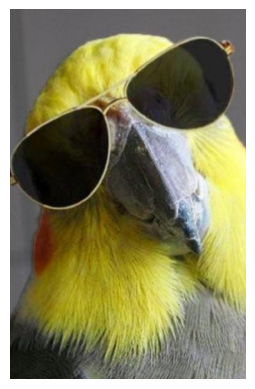

'/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBwcJCQgKDBQNDAsLDBkSEw8UHRofHh0aHBwgJC4nICIsIxwcKDcpLDAxNDQ0Hyc5PTgyPC4zNDL/2wBDAQkJCQwLDBgNDRgyIRwhMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjL/wAARCAJBAXADASIAAhEBAxEB/8QAHwAAAQUBAQEBAQEAAAAAAAAAAAECAwQFBgcICQoL/8QAtRAAAgEDAwIEAwUFBAQAAAF9AQIDAAQRBRIhMUEGE1FhByJxFDKBkaEII0KxwRVS0fAkM2JyggkKFhcYGRolJicoKSo0NTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqDhIWGh4iJipKTlJWWl5iZmqKjpKWmp6ipqrKztLW2t7i5usLDxMXGx8jJytLT1NXW19jZ2uHi4+Tl5ufo6erx8vP09fb3+Pn6/8QAHwEAAwEBAQEBAQEBAQAAAAAAAAECAwQFBgcICQoL/8QAtREAAgECBAQDBAcFBAQAAQJ3AAECAxEEBSExBhJBUQdhcRMiMoEIFEKRobHBCSMzUvAVYnLRChYkNOEl8RcYGRomJygpKjU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6goOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4uPk5ebn6Onq8vP09fb3+Pn6/9oADAMBAAIRAxEAPwDle9Hej+KjoaYE8fQVKajj+7UmKQxD0pc0cUHigApMUtFMBMUhNOzSYoATA9KWijvQAlGaUjijFAg6ijJAxQBil70DADHSilo60AGaKKMUAFLg0Y5oxQAnWl6UYoNAC0UlLQAUUoFIPvUgE/Cl47UpHNHPegBMj0ozng0uKKY

In [6]:
# Copy and paste
def encode_image_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')
    
def display_image(image_uri):
    image = Image.open(image_uri)
    plt.imshow(image)
    plt.axis('off')
    plt.show()
    
# See the image we're working with
image_uri = "./Images/1548d06a49fccb050deaf74b443a0a59.jpg"
display_image(image_uri)

# Encode the image
encoded_image = encode_image_base64(image_uri)
encoded_image

### Ask the Model for Image Tags

* Now multi-modal messages do require a bit more structure in the prompt. So we need to create a message object. This is going to be a HumanMessage object since it’s a message from us to the model. 
* The content of this message/prompt is going to be a list of dictionaries, each of which is a part of the message. So the first one is going to be our actual text explaining to the model what we want it to do. And the next one is going to be the actual encoded image.


In [7]:
# Copy and Paste
message = HumanMessage(content=[
        {
            # The text input explaining to the model what we want it to do
            "type": "text", 
            "text": "Provide a list of tags for this image."
        },
        {
            # The image input
            "type": "image_url",
            "image_url": {"url": f"data:image/jpeg;base64,{encoded_image}"},
        }
])

In [8]:
# Live code
# The prompt itself needs to be in the format of a list of messages
prompt = [message]
# Now we just pass it to our model object as normal and get back the response
response = llm.invoke(prompt)
print(response.content)

- Parrot
- Sunglasses
- Cool
- Bird
- Aviator sunglasses
- Yellow feathers
- Fun
- Animal
- Pet
- Stylish
- Close-up
- Headshot
- Quirky
- Fashionable
- Humor


* And there ya go, there’s you tags pulled out from the image

### Make the Output Structured

* Is there are particular structure that you would like?
* Okay we can do JSON, and I’ll actually take it a step further and create an object from the response as well. 
* So let’s define that object that we want. As long as we’re getting information from the model let’s ask it for a description as well as that list of tags.


In [9]:
# Live Code
class ImageInfo(BaseModel):
    '''Description and Tags for an Image'''
    description: str = Field(description='description of the image.')
    tags: list[str] = Field(description='tags for the image.')

* Now we could just ask the model nicely to format its response as a json. But to make sure it does it correctly you really have to be precise and thorough in your formatting instructions. Luckily langchain makes this easy and does it for us with what are called ‘parsers’
* So let’s use our class definition to create a JSON parser, and a pydantic object parser. 

In [10]:
# Live Code
json_output_parser = JsonOutputParser(pydantic_object=ImageInfo)
pydantic_output_parser = PydanticOutputParser(pydantic_object=ImageInfo)

* Then we can just use the ‘get_format_instructions()’ method to generate instructions that we add to our prompt. 

In [11]:
# Live Code
print(json_output_parser.get_format_instructions())

The output should be formatted as a JSON instance that conforms to the JSON schema below.

As an example, for the schema {"properties": {"foo": {"title": "Foo", "description": "a list of strings", "type": "array", "items": {"type": "string"}}}, "required": ["foo"]}
the object {"foo": ["bar", "baz"]} is a well-formatted instance of the schema. The object {"properties": {"foo": ["bar", "baz"]}} is not well-formatted.

Here is the output schema:
```
{"description": "Description and Tags for an Image", "properties": {"description": {"title": "Description", "description": "description of the image.", "type": "string"}, "tags": {"title": "Tags", "description": "tags for the image.", "type": "array", "items": {"type": "string"}}}, "required": ["description", "tags"]}
```


* You can see it explains the structure based on our class definition, and actually gives the model examples of good and bad formatting. 
* Now we pass these instructions in as a new part of our message

In [12]:
# Copy and Paste
format_instructions = pydantic_output_parser.get_format_instructions()
message = HumanMessage(content=[
        {
            "type": "text", 
            "text": "Provide a description and a list of tags for this image."
        },
        {
            "type": "text", 
            "text": f"{format_instructions}"
        },
        {
            "type": "image_url",
            "image_url": {"url": f"data:image/jpeg;base64,{encoded_image}"},
        }
])
prompt = [message]
response = llm.invoke(prompt)
response.content

'```json\n{\n  "description": "A close-up image of a parrot wearing aviator sunglasses. The parrot has a yellow head and green feathers.",\n  "tags": [\n    "parrot",\n    "bird",\n    "sunglasses",\n    "aviator sunglasses",\n    "close-up",\n    "yellow",\n    "green",\n    "funny",\n    "cool"\n  ]\n}\n```'

In [13]:
# prompt = ChatPromptTemplate.from_messages([message])
# chain = prompt | llm | json_output_parser
# response = chain.invoke({})

* Output looks close to what we want, but as a final step to get it from a string to the right type we pass the response into the parser invoke function and we get back the right structure that we were looking for. 
* Here’s the json


In [14]:
# Live Code
json_response = json_output_parser.invoke(response)
print(json.dumps(json_response, indent=4))

{
    "description": "A close-up image of a parrot wearing aviator sunglasses. The parrot has a yellow head and green feathers.",
    "tags": [
        "parrot",
        "bird",
        "sunglasses",
        "aviator sunglasses",
        "close-up",
        "yellow",
        "green",
        "funny",
        "cool"
    ]
}


* And then here’s the data as an object

In [15]:
# Live Code
object_response = pydantic_output_parser.invoke(response)
object_response

ImageInfo(description='A close-up image of a parrot wearing aviator sunglasses. The parrot has a yellow head and green feathers.', tags=['parrot', 'bird', 'sunglasses', 'aviator sunglasses', 'close-up', 'yellow', 'green', 'funny', 'cool'])

* And we can look at the tags attribute to get those tags we wanted. 

In [16]:
# Live Code
object_response.tags

['parrot',
 'bird',
 'sunglasses',
 'aviator sunglasses',
 'close-up',
 'yellow',
 'green',
 'funny',
 'cool']

* And let me just put that image back up here as a reminder of what we were doing

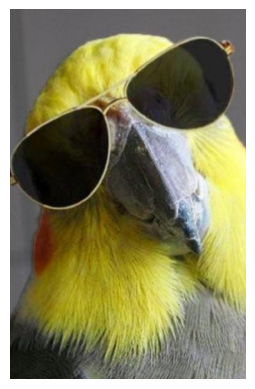

In [17]:
# Live Code
display_image(image_uri)

### Show How Tag Search Would Perform

In [18]:
# # Don't show this - just saw that we have a file of a bunch of bird photos
# # with their generated tags
# def get_data_from_all_images(images_dir):
#     image_files = os.listdir(images_dir)
#     image_uris = [os.path.join(images_dir, image_file) for image_file in image_files]
    
#     json_output_parser = JsonOutputParser(pydantic_object=ImageInfo)
#     format_instructions = json_output_parser.get_format_instructions()
#     with open('image_data.json', 'r') as file:
#         old_image_data = json.load(file)
        
#     new_image_data = {}
#     for image_uri in image_uris:
#         if image_uri in old_image_data:
#             new_image_data[image_uri] = old_image_data[image_uri]
#         else:
#             print(image_uri)
#             encoded_image = encode_image_base64(image_uri)
#             message = HumanMessage(content=[
#                     {
#                         "type": "text", 
#                         "text": "Provide a description and a list of tags for this image."
#                     },
#                     {
#                         "type": "text", 
#                         "text": f"{format_instructions}"
#                     },
#                     {
#                         "type": "image_url",
#                         "image_url": {"url": f"data:image/jpeg;base64,{encoded_image}"},
#                     }
#             ])
#             prompt = [message]
#             response = llm.invoke(prompt)
#             json_response = json_output_parser.invoke(response)
#             new_image_data[image_uri] = json_response
        
#     # Write the dictionary to a JSON file
#     with open('image_data.json', 'w') as file:
#         json.dump(new_image_data, file, indent=4)


#get_data_from_all_images(images_dir='Images')

* Let's see how well this tag search would perform.
* I have a whole folder of bird photos tagged with this model just lying around on my laptop (for some reason 😊). Let’s use that to simulate and image search based on tags. 
* Let’s load that file

* And here’s a function to search those images based on the tags. 

In [19]:
# Copy and Paste
with open('image_data.json', 'r') as file:
    image_data = json.load(file)
    
def search_by_tag(tag, image_data):
    matching_images = [path for path, details in image_data.items() if tag in details['tags']]
    
    for image_uri in matching_images:
        image = Image.open(image_uri)
        plt.imshow(image)
        plt.axis('off')
        plt.show()

* Let’s start with the obvious tag, just to see what images we’re working with…

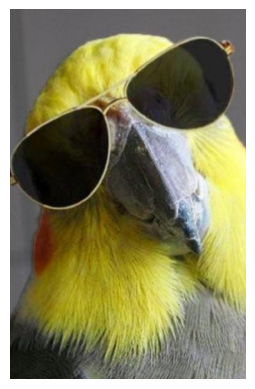

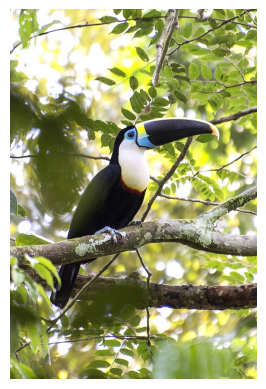

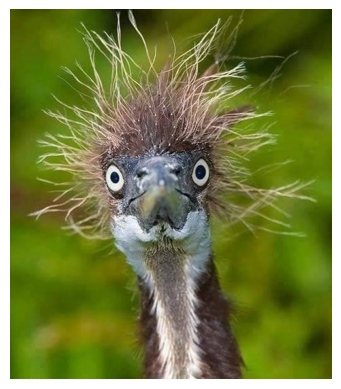

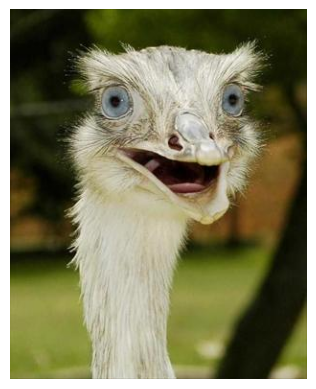

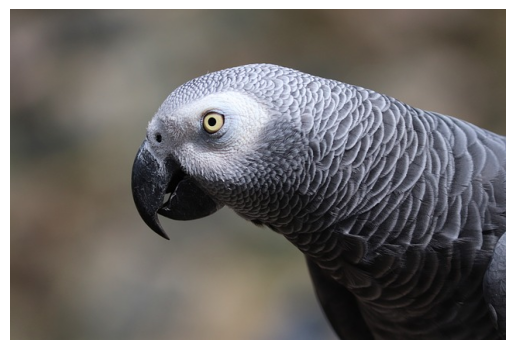

...

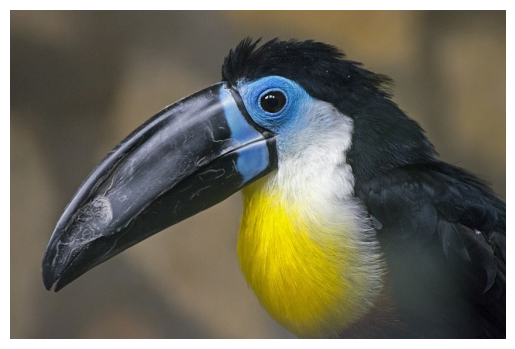

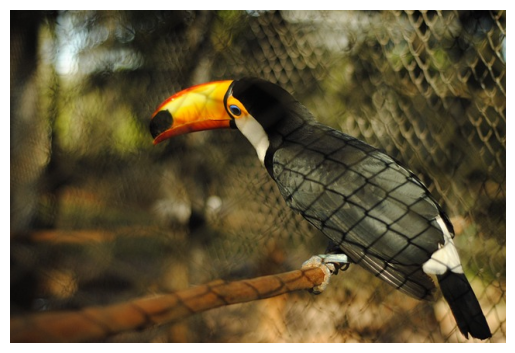

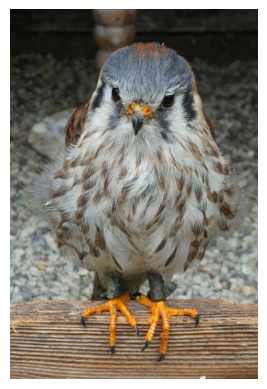

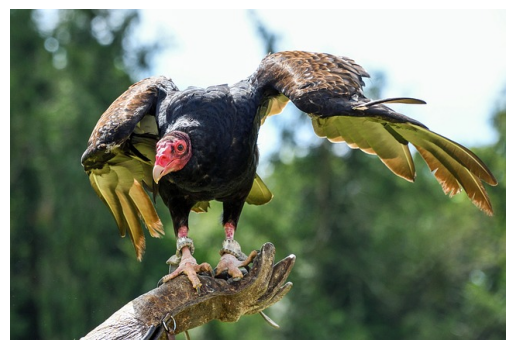

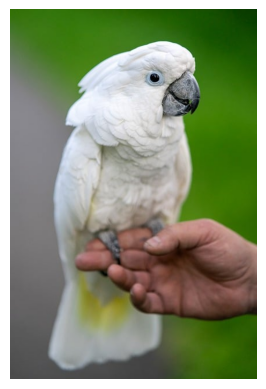

In [20]:
# Live Code
search_by_tag('bird', image_data)

* Let’s try a bit more specific one to see if we can find our image we were working with before

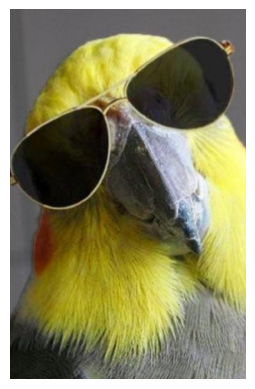

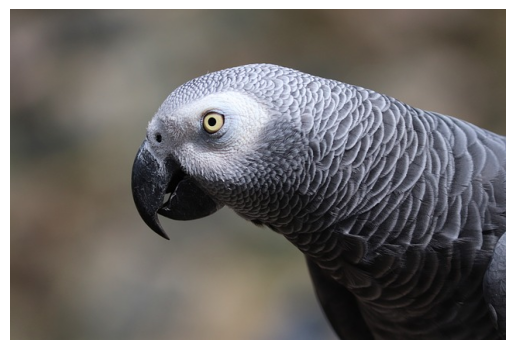

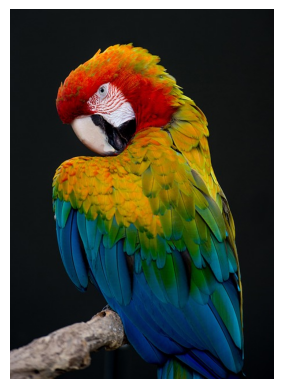

In [21]:
# Live Code
search_by_tag('parrot', image_data)

* Awesome. Now, we know users are rarely satisfied with basic functionality like this, let’s instead use another tag another tag we know we had on our photo

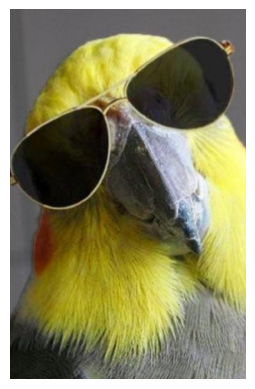

In [22]:
# Live Code
search_by_tag('funny', image_data)

* Cool, looks like this was the only one tagged as funny. But what if our user uses a synonym instead of the actual tag?

In [23]:
# Live Code
search_by_tag('comical', image_data)

* Or something that means something similar but not quite the same?

In [24]:
# Live Code
search_by_tag('goofy', image_data)

* So doesn’t look like we come up with any photos for those. 
* This really shows the limitations of this process. 
* We also can’t really extend this process. What is we wanted to actually use an image search this database for images that are similar? Can’t do that either.
* But….I can let you in on another piece of data science power that will make this much better. But you have to use that power for good 😊

# Vector Explanation

* This other piece of data science power is something that we use as the backbone several branches of data science like natural language process and computer vision, and that is vectors. Vectors are a tool that, when used alongside LLMs, really take everything to a new level.
* So to get this new power you need to bare with me for just a minute as I take us back to high school geometry class. After this you can actually tell your geometry teacher you used it in real life!

[Flip to slides]

# Use Vectors for Image Search

* We can use a model to turn all of our images into vectors. I’m going to be using an open source version of OpenAI’s CLIP model, which is able to convert both text and images into vectors in the same meaning space. 

In [25]:
# Copy and Paste and run before the talk
model_name = "ViT-g-14"
checkpoint = "laion2b_s34b_b88k"
clip_embd = OpenCLIPEmbeddings(model_name=model_name, checkpoint=checkpoint)

C:\Users\emily.lynn\OneDrive - Slalom\Documents\Presentations\Dev Up\dev_ds\lib\site-packages\open_clip\factory.py:129: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpo

* If you look at the model, its super cool, its got a vision transformer, with a convolutional neural network…

In [26]:
# Live Code
print(clip_embd)

model=CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 1408, kernel_size=(14, 14), stride=(14, 14), bias=False)
    (patch_dropout): Identity()
    (ln_pre): LayerNorm((1408,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): ModuleList(
        (0-39): 40 x ResidualAttentionBlock(
          (ln_1): LayerNorm((1408,), eps=1e-05, elementwise_affine=True)
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=1408, out_features=1408, bias=True)
          )
          (ls_1): Identity()
          (ln_2): LayerNorm((1408,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=1408, out_features=6144, bias=True)
            (gelu): GELU(approximate='none')
            (c_proj): Linear(in_features=6144, out_features=1408, bias=True)
          )
          (ls_2): Identity()
        )
      )
    )
    (ln_post): LayerNorm((1408,), eps=1e-05, ele

* Fine, you developers are so boring...Let’s just use this model like we use the LLM model before – as an object with methods that we can use. 
* I’ve gone ahead and already vectored our whole set of images. So let's load that file and get those image vectors.

* Just to give you an idea of what these vectors look like [print one] they actually have 1024 numbers, which are 1024 features about the image, which technically means we’re working with a 1024-dimensional space!

In [27]:
# Copy and Paste
# Load the image vectors
with open('image_vectors.json', 'r') as file:
    image_vectors_json = json.load(file)
    
image_vectors = list(image_vectors_json.values())
image_uris = list(image_vectors_json.keys())

print(image_vectors[0])

[-0.02149762213230133, 0.021951809525489807, -0.03716243430972099, 0.01655275747179985, 0.01976323500275612, 0.017215406522154808, -0.011026652529835701, 0.0037407472264021635, -0.026849662885069847, 0.06402450799942017, -0.006236241199076176, 0.005138401407748461, 0.013164980337023735, 0.0008353481534868479, 0.01872362196445465, 0.0063811675645411015, -0.016873925924301147, 0.05318961292505264, 0.013760912232100964, 0.022540230304002762, 0.039307981729507446, -0.028852488845586777, -0.012332267127931118, -0.030955053865909576, 0.0417485386133194, -0.003427405608817935, 0.0051943473517894745, 0.005985495168715715, 0.0035694343969225883, -0.03452751412987709, 0.01607680134475231, -0.021735824644565582, -0.0058862194418907166, 0.03941383212804794, -0.021221023052930832, -0.017361830919981003, -0.012740898877382278, -0.0927462950348854, 0.006967019755393267, -0.0034367116168141365, -0.003460184670984745, 0.0702352449297905, 0.012694530189037323, 0.006526673678308725, 0.013096806593239307,

* Now if we want to search those images based upon a user’s text search all we have to do is turn that search text into a vector in the meaning space, and see which images vectors are closest to it. 
* Let's see what a search text would look like as a vector...

In [28]:
# Live code
query = "funny bird"
query_vector = clip_embd.embed_documents([query])
print(query_vector)

[[-0.023754702880978584, 0.00452071288600564, 0.04080920293927193, -0.09264715015888214, -0.014911815524101257, 0.0015906220069155097, -0.001967847580090165, -0.02721460349857807, -0.03058633580803871, 0.02525000460445881, -0.007889285683631897, 0.003639922710135579, -0.03802420198917389, -0.008053644560277462, -0.013013385236263275, -0.01555814128369093, 0.04013180360198021, 0.007978306151926517, 0.001159361214376986, 0.04191677272319794, 0.04351486638188362, -0.0052586025558412075, -0.0023120080586522818, -0.04091378673911095, 0.015404877252876759, -0.011596101336181164, 0.02530164085328579, -0.017089085653424263, -0.0038519457448273897, -0.02354804240167141, 0.042714547365903854, 0.032592546194791794, -0.03951622545719147, 0.026190081611275673, 0.008375512436032295, -0.01461533922702074, -0.0016079015331342816, -0.02931934781372547, -0.03161528706550598, 0.0023968524765223265, 0.014612236060202122, 0.07808727025985718, -0.02179945819079876, -0.018059615045785904, 0.00714586535468697

* Let’s create that function to find which image vectors are closest to this search text…

* And then here’s just a function to display those images in descending order from most similar to least similar with their similarity scores

In [29]:
# Copy and Paste
def search_images(query_vector, image_vectors):
    #query_vector = np.array(query_vector)
    similarities = cosine_similarity(query_vector, image_vectors)[0]
    sorted_indices = np.argsort(similarities)[::-1]
    return sorted_indices, similarities

def display_images_with_scores(image_uris, scores, sorted_indices):
    plt.figure(figsize=(5, len(sorted_indices) * 3))
    
    for i, idx in enumerate(sorted_indices):
        img = mpimg.imread(image_uris[idx])
        
        # Display image
        plt.subplot(len(sorted_indices), 1, i + 1)
        plt.imshow(img)
        plt.title(f"Score: {scores[i]:.2f}")
        plt.axis('off')  # Hide axes
    
    plt.tight_layout()
    plt.show()

In [30]:
# Don't show this - just saw that we have a file of a bunch of bird photos
# with their generated tags
# def embed_all_images(images_dir):
#     image_files = os.listdir(images_dir)
#     image_uris = [os.path.join(images_dir, image_file) for image_file in image_files]
    
#     with open('image_vectors.json', 'r') as file:
#         old_image_vectors = json.load(file)
        
#     new_image_vectors = {}
#     for image_uri in image_uris:
#         if image_uri in old_image_vectors:
#             new_image_vectors[image_uri] = old_image_vectors[image_uri]
#         else:
#             print(image_uri)
#             image_vector = clip_embd.embed_image([image_uri])[0]
#             new_image_vectors[image_uri] = image_vector
        
#     # Write the dictionary to a JSON file
#     with open('image_vectors.json', 'w') as file:
#         json.dump(new_image_vectors, file, indent=4)

# embed_all_images(images_dir = "Images")

* Let’s see what we get for ‘funny bird’, which is actually a search that our tags did find our image with...

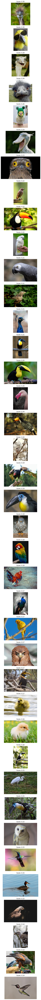

In [31]:
#Live Code
query = "funny bird"
query_vector = clip_embd.embed_documents([query])
sorted_images, scores = search_images(query_vector, image_vectors)
display_images_with_scores(image_uris, scores[sorted_images], sorted_images)

* Looks like our image does come up, and we actually find some other images that match that never showed up when we used the ‘funny’ tag before! For each image you can see the similarity score, and the lower down the list we see the lower the score and the less the photo matches our search text. 
* Let’s see what happens if we use a different wording

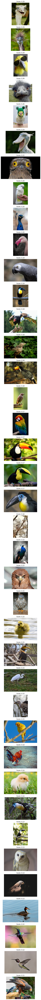

In [32]:
#Live Code
query = "silly bird"
query_vector = clip_embd.embed_documents([query])
sorted_images, scores = search_images(query_vector, image_vectors)
display_images_with_scores(image_uris, scores[sorted_images], sorted_images)

* We still get those same images, so now instead of being constrained by a finite set of tags, we’re actually working with a representation of the data that takes into account the meaning instead of just specific words. 
* This can even handle ideas that would never even end up in tags.


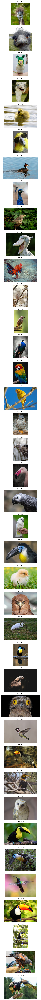

In [33]:
#Live Code
query = "bad hair day"
query_vector = clip_embd.embed_documents([query])
sorted_images, scores = search_images(query_vector, image_vectors)
display_images_with_scores(image_uris, scores[sorted_images], sorted_images)

# Show Reverse Image Search

* And as long as long as we have that query vector it doesn’t matter where it came from. So I can actually do the reverse image search without changing anything about this setup. All I have to do is instead of the search vector being made from a text string, now its just made from an image. 
* So say we wanted to find photos of this specific type of tucan. Not just any tucan – this specific one. This is an important distinction if we were working with thousands of images. 
* I embed this image, and use it as the search vector…
* Now you can see that we have a lot of pictures of tucans up at the top, but the ones that are the most like the original are first because they are the most similar to the original query vector. 

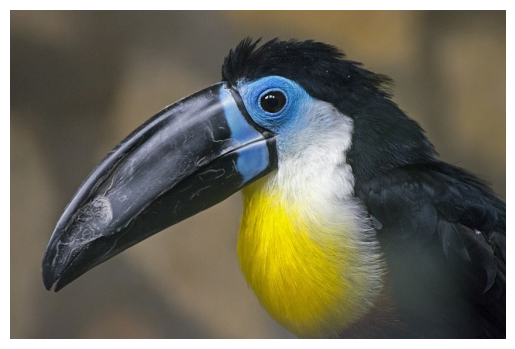

In [35]:
display_image("./Images/toucan-4185361_640.jpg")

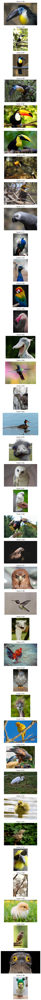

In [36]:
# Copy and paste same code from above, replace query with image path
# and replace 'embed_documents' with 'embed_image'
query = "./Images/toucan-4185361_640.jpg"
query_vector = clip_embd.embed_image([query])
sorted_images, scores = search_images(query_vector, image_vectors)
display_images_with_scores(image_uris, scores[sorted_images], sorted_images)